# **Hi! Paris Hackathon**

## **Group 21: AI & Sustainability**

The goal is to build an AI model that can predict the watertable/ground water levels of french piezometric stations, with a focus on the summer months. To build this model, you were given piezometric/watertable, weather, hydrology, water withdrawal and economic data. But beyond producing an AI model, the competition will ask you to realistically project your solution in a market / real-world context.

The full dataset contains over 3 million rows with 136 columns. It was split into a train/test set.
- Train set (`X_train_Hi5.csv`): The dataset has around 2 800 000 rows. It contains data between 2020 and 2023, excluding the summer months (june, july, august, september) of 2022 and 2023.
- Test set (`X_test_Hi5.csv`): The contains has around 600 000 rows. It contains data for the 2022 and 2023 summer months (june, july, august, september).
- Test submission example (`y_test_submission_example_Hi5.csv`): Please follow this example to submit results to the leaderboard. The "row_index" variable is a unique identifier of each row, to match the values

The target variable to predict is `piezo_groundwater_level_category`.

---

## **Import libraries**

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import seaborn as sns
import numpy as np

## **Load data**

In [2]:
train = pd.read_csv('X_train_Hi5.csv') 
test = pd.read_csv('X_test_Hi5.csv')

# train = pd.read_csv('X_train_Hi5.csv', nrows=50_000)  
# test = pd.read_csv('X_test_Hi5.csv', nrows=10_000)

C:\Users\Bradf\AppData\Local\Temp\ipykernel_4140\1624681743.py:1: DtypeWarning: Columns (108,110,111,115,117,118,122,124,125) have mixed types. Specify dtype option on import or set low_memory=False.
  train = pd.read_csv('X_train_Hi5.csv')
C:\Users\Bradf\AppData\Local\Temp\ipykernel_4140\1624681743.py:2: DtypeWarning: Columns (1,5,108,110,111,115,117,118,122,124,125) have mixed types. Specify dtype option on import or set low_memory=False.
  test = pd.read_csv('X_test_Hi5.csv')


## **Understand data properties**

In [3]:
numerical_cols = train.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = train.select_dtypes(include=['object']).columns

numerical_cols_test = test.select_dtypes(include=['float64', 'int64']).columns
categorical_cols_test = test.select_dtypes(include=['object']).columns

print(f"Train set has {train.shape[0]} rows and {train.shape[1]} columns")
print(f"Test set has {test.shape[0]} rows and {test.shape[1]} columns")
print(f"Train set has {len(numerical_cols)} numerical columns and {len(categorical_cols)} categorical columns")
print(f"Test set has {len(numerical_cols_test)} numerical columns and {len(categorical_cols_test)} categorical columns")

Train set has 2830316 rows and 136 columns
Test set has 611208 rows and 135 columns
Train set has 96 numerical columns and 40 categorical columns
Test set has 96 numerical columns and 39 categorical columns


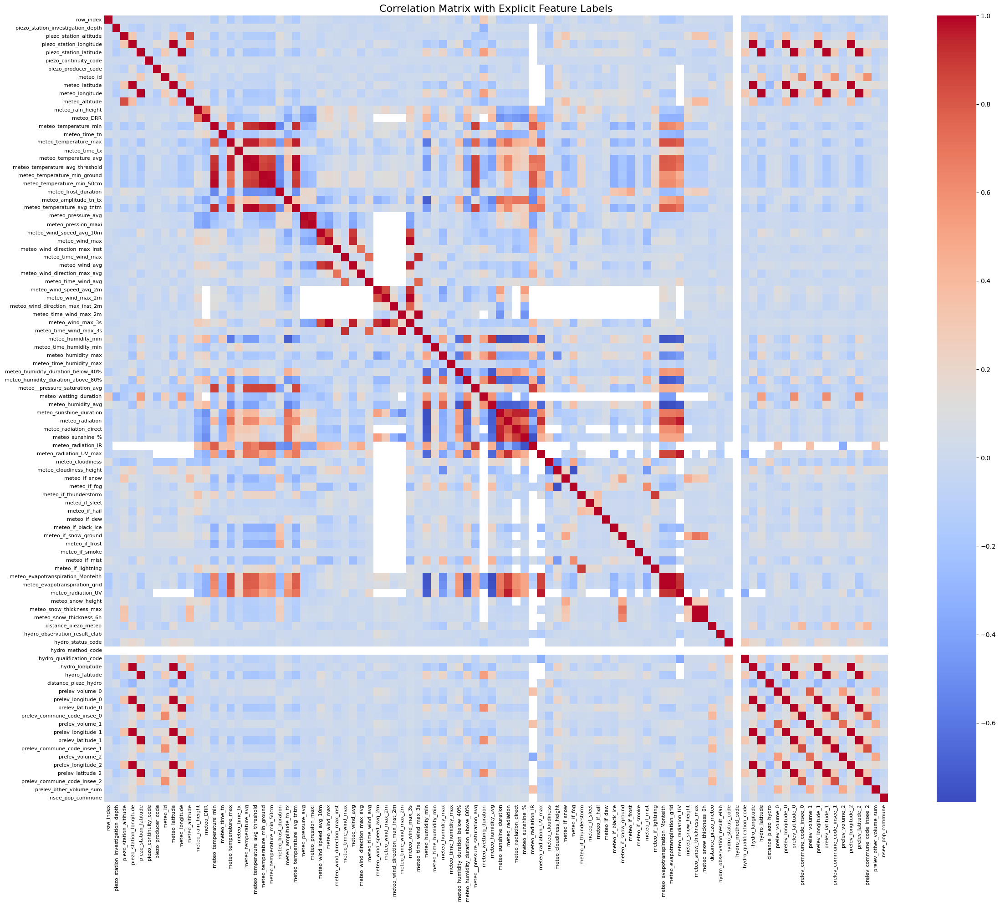

In [4]:
numeric_features = train.select_dtypes(include=['float64', 'int64']).columns
corr_matrix = train[numeric_features].corr()

plt.figure(figsize=(24, 20))  
ax = sns.heatmap(corr_matrix, annot=False, cmap='coolwarm', fmt=".2f", cbar=True)

ax.set_xticks(np.arange(len(corr_matrix.columns)) + 0.5)  
ax.set_yticks(np.arange(len(corr_matrix.index)) + 0.5)
ax.set_xticklabels(corr_matrix.columns, rotation=90, fontsize=8)  
ax.set_yticklabels(corr_matrix.index, rotation=0, fontsize=8)

ax.tick_params(axis='x', which='both', length=0)  
ax.tick_params(axis='y', which='both', length=0)

plt.title('Correlation matrix with explicit feature labels', fontsize=16)
plt.tight_layout()
plt.show()

## **Visualize data localisation temporally**

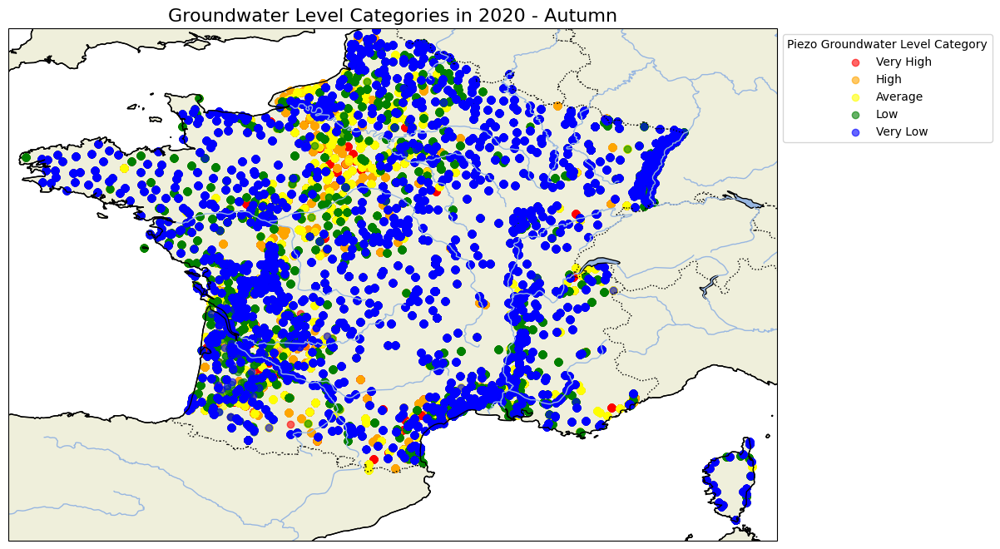

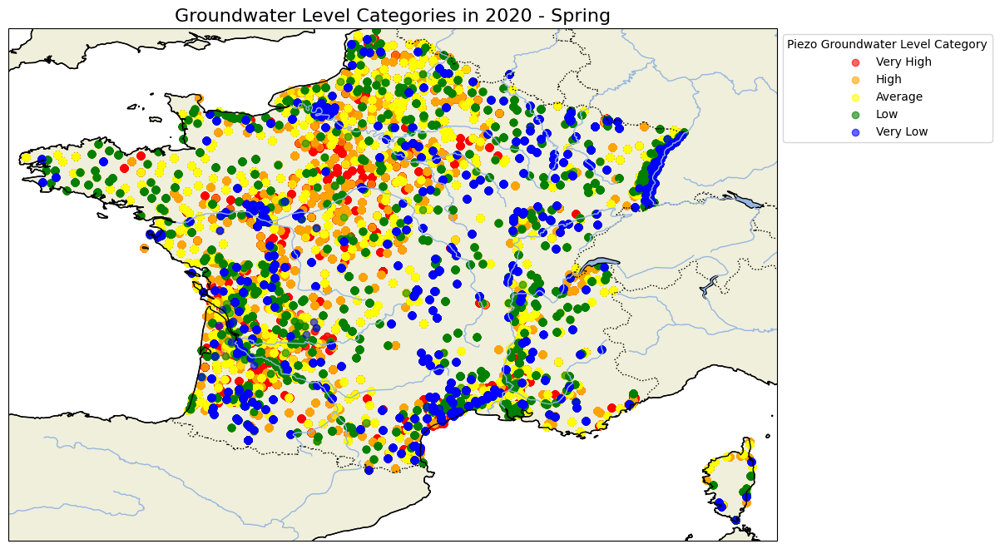

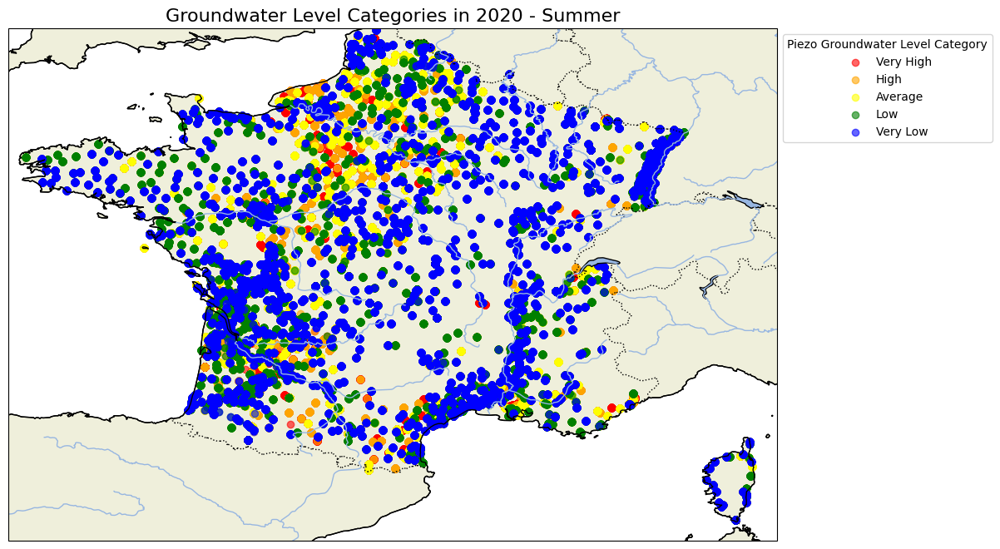

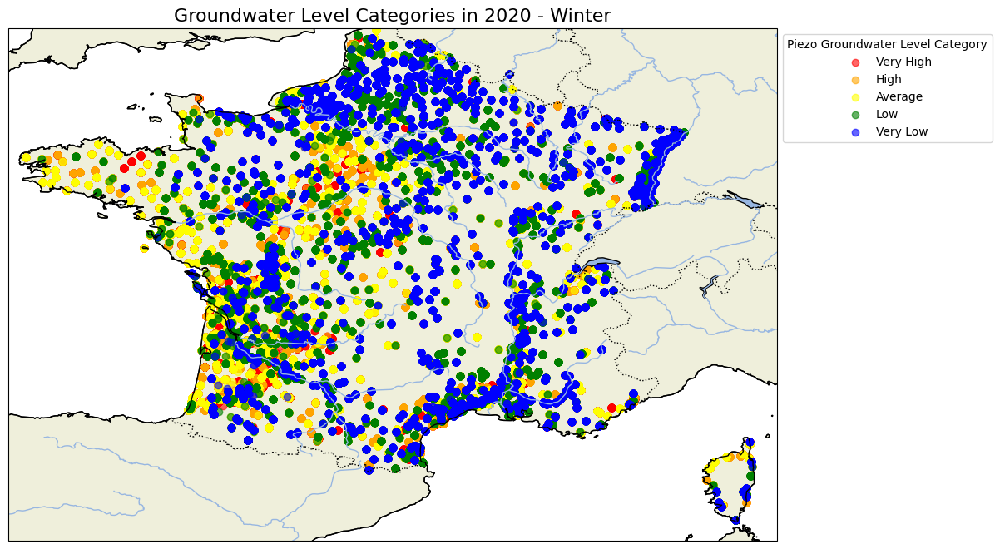

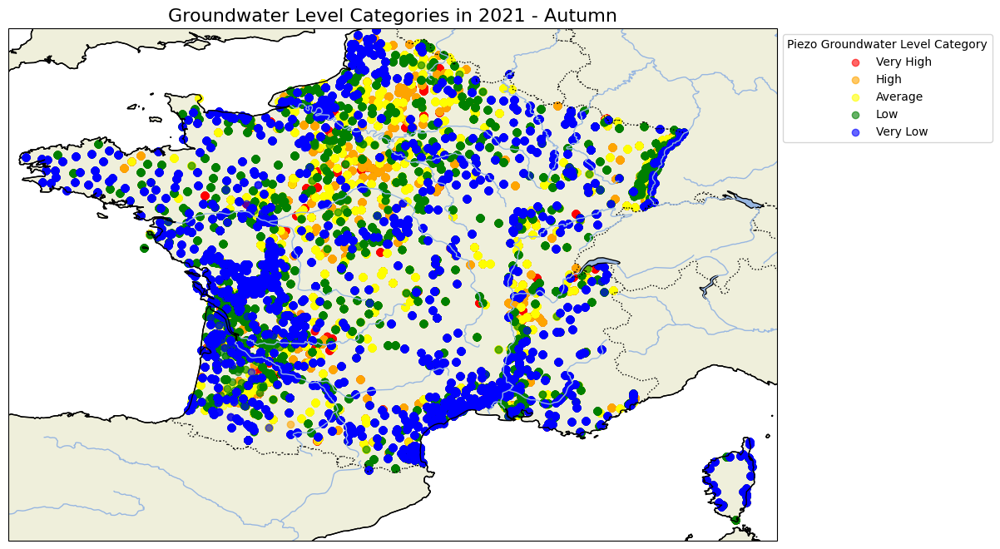

...

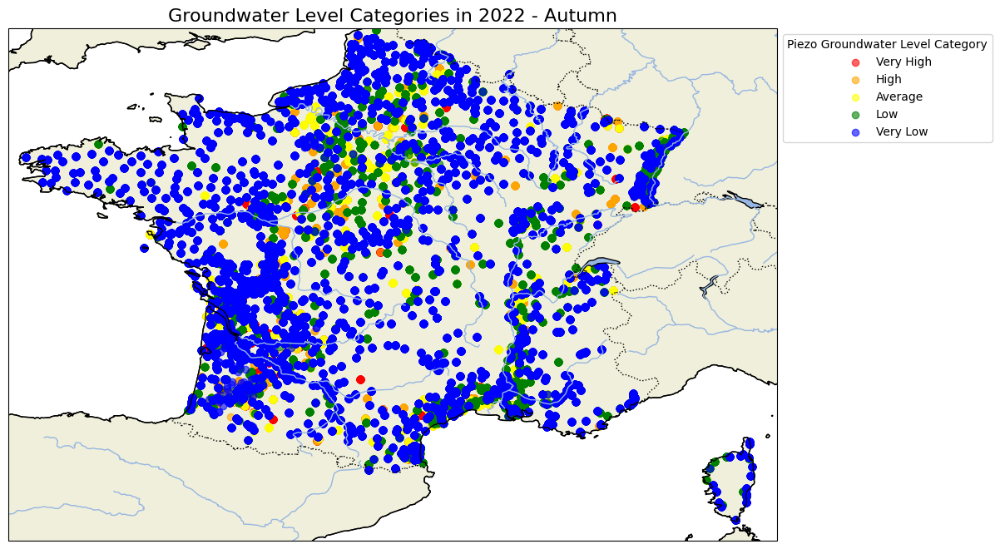

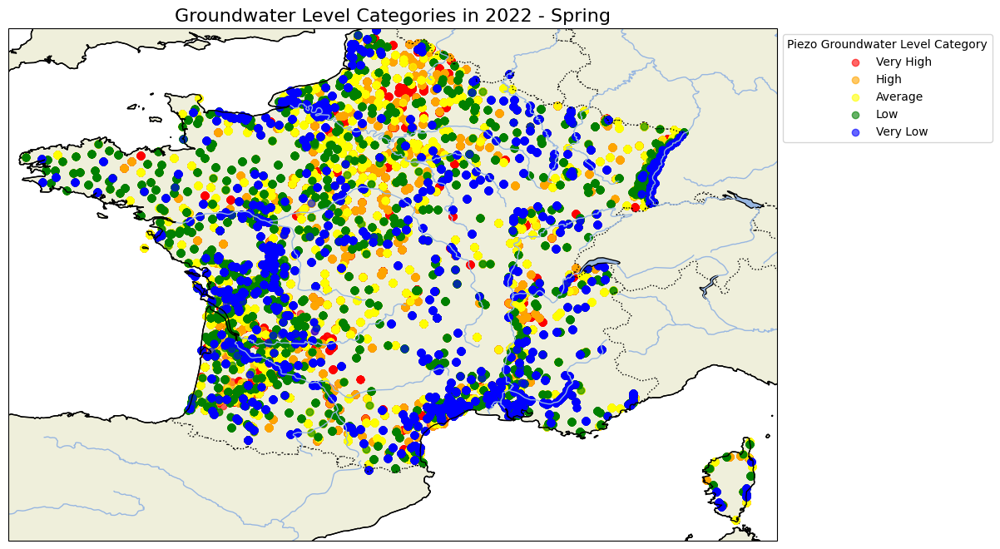

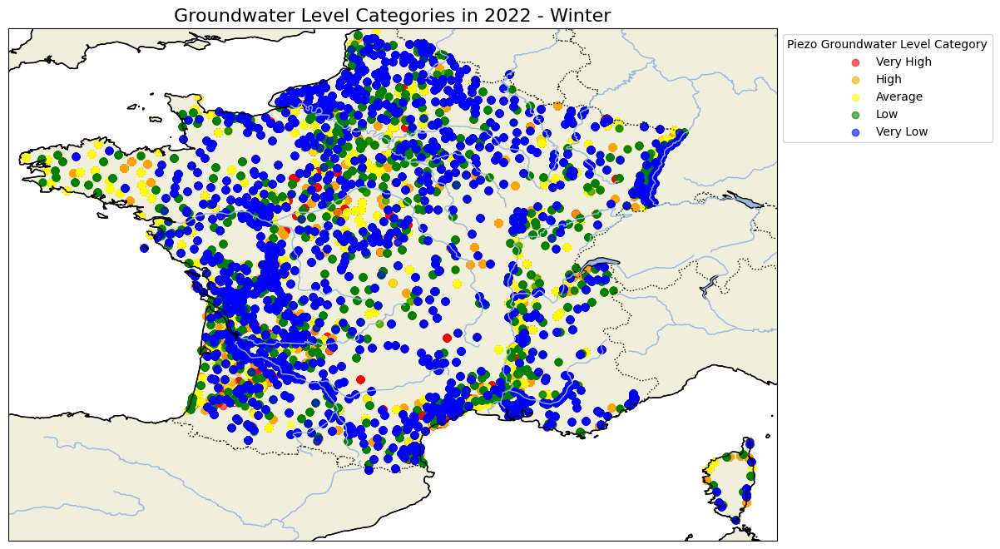

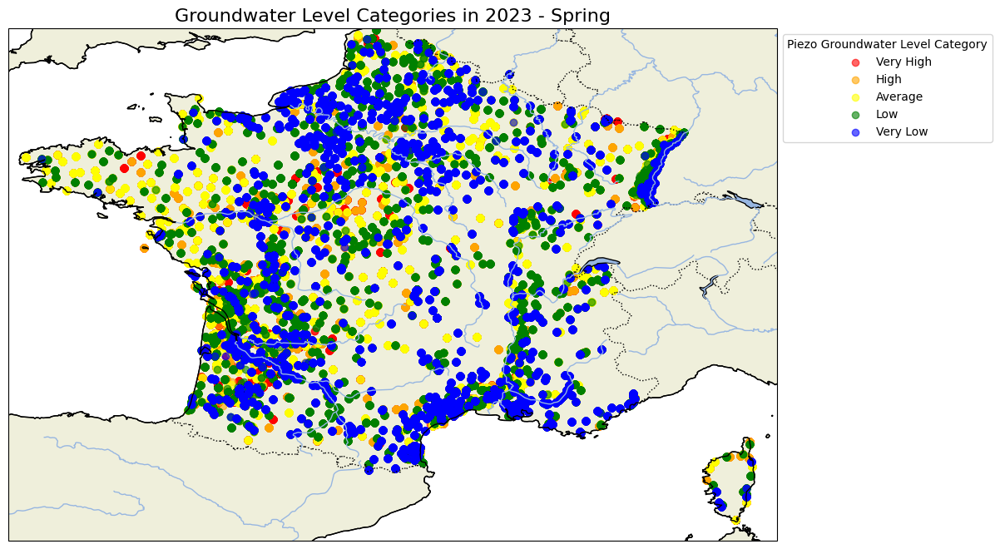

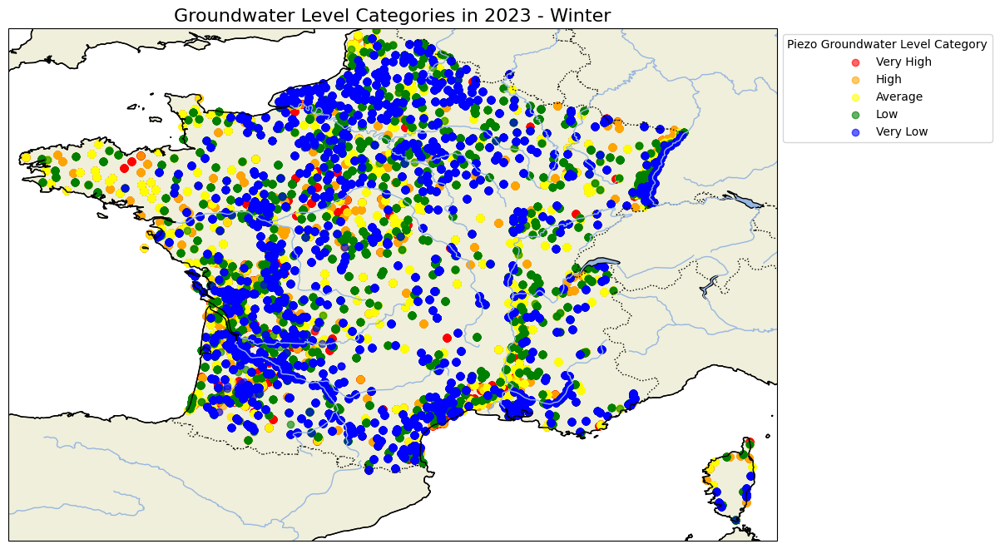

In [5]:
def assign_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return None
    
date_col = 'piezo_measurement_date'

longitude_col = 'piezo_station_longitude'
latitude_col = 'piezo_station_latitude'

train['update_year'] = pd.to_datetime(train[date_col], errors='coerce').dt.year
train['update_month'] = pd.to_datetime(train[date_col], errors='coerce').dt.month

train['season'] = train['update_month'].apply(assign_season)

data_with_year_season = train.dropna(subset=['update_year', 'season'])

unique_year_season = sorted(
    [tuple(x) for x in data_with_year_season[['update_year', 'season']].drop_duplicates().values]
)

categories = ['Very High', 'High', 'Average', 'Low', 'Very Low']
colors = ['red', 'orange', 'yellow', 'green', 'blue']
category_color_map = dict(zip(categories, colors))

for year, season in unique_year_season:
    year_season_data = data_with_year_season[
        (data_with_year_season['update_year'] == year) & 
        (data_with_year_season['season'] == season)
    ]
    
    plt.figure(figsize=(12, 8))
    ax = plt.axes(projection=ccrs.PlateCarree())

    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.LAKES, edgecolor='black')
    ax.add_feature(cfeature.RIVERS)

    min_longitude, max_longitude = -5, 10
    min_latitude, max_latitude = 41, 51
    ax.set_extent([min_longitude, max_longitude, min_latitude, max_latitude], crs=ccrs.PlateCarree())

    for category in categories:
        subset = year_season_data[year_season_data['piezo_groundwater_level_category'] == category]
        ax.scatter(
            subset[longitude_col],
            subset[latitude_col],
            color=category_color_map[category],
            label=category,
            alpha=0.6,
            transform=ccrs.PlateCarree()
        )

    plt.legend(title='Piezo Groundwater Level Category', loc='upper left', bbox_to_anchor=(1, 1))
    plt.title(f'Groundwater Level Categories in {year} - {season}', fontsize=16)
    plt.show()

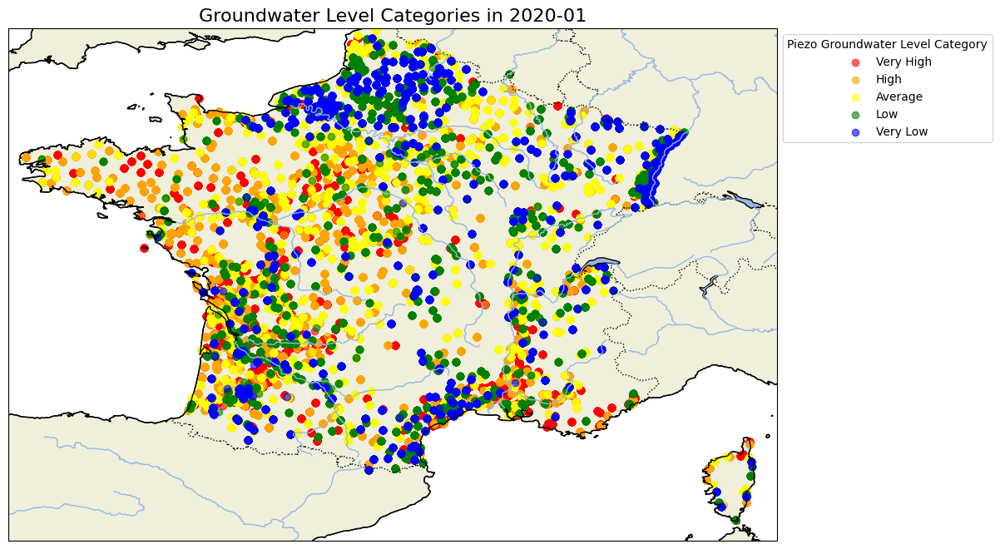

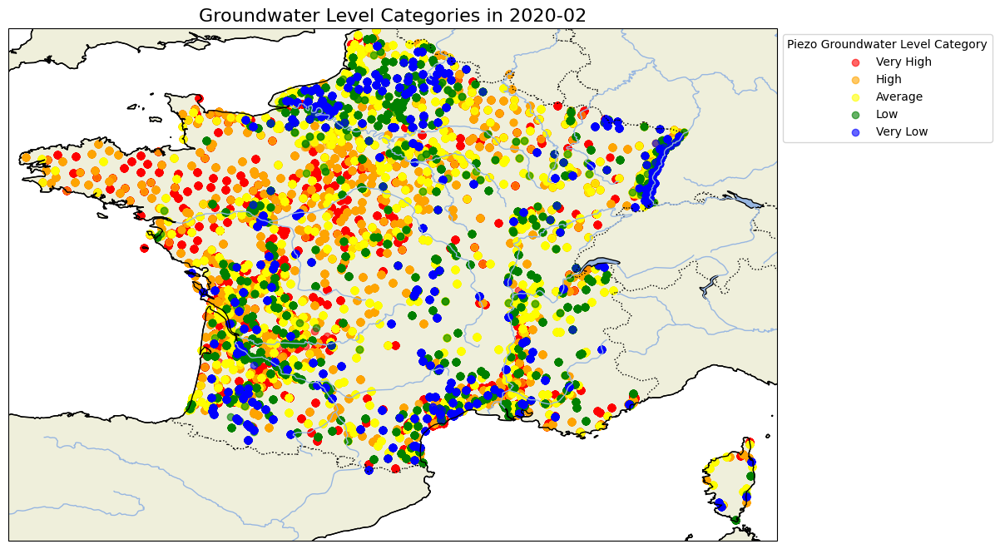

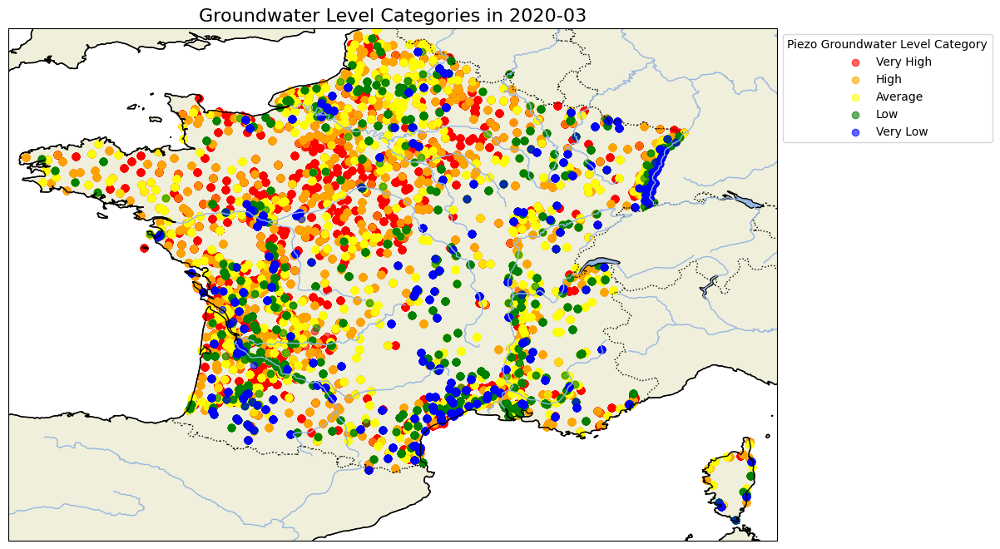

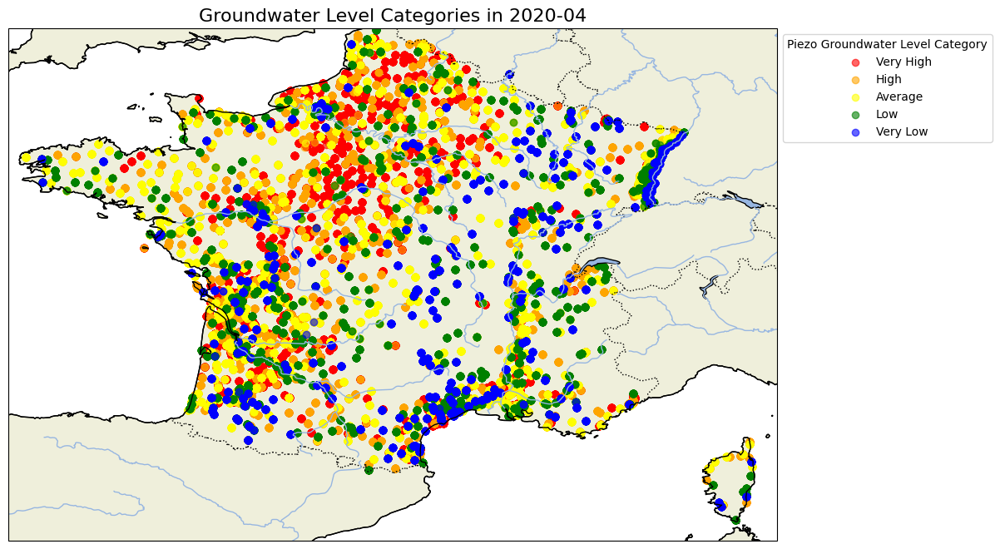

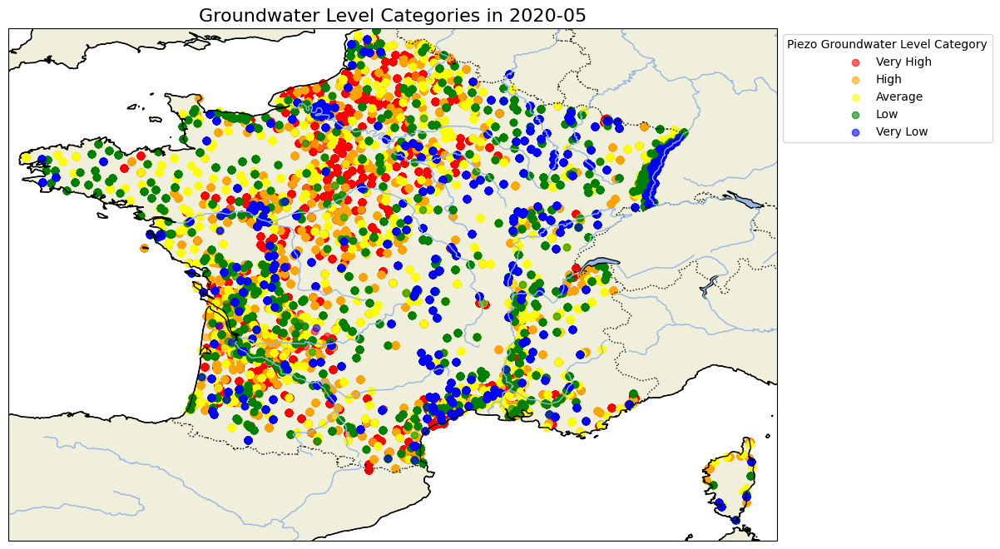

...

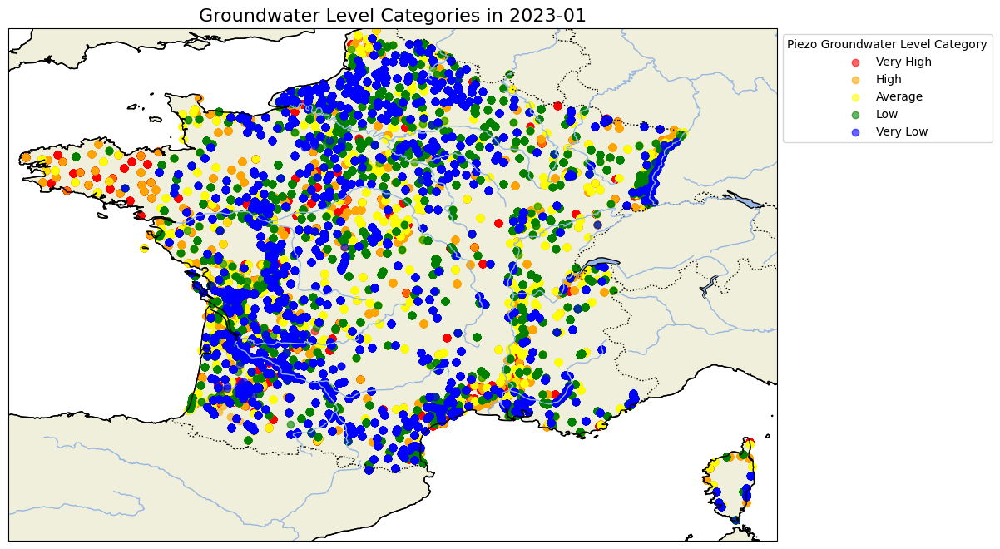

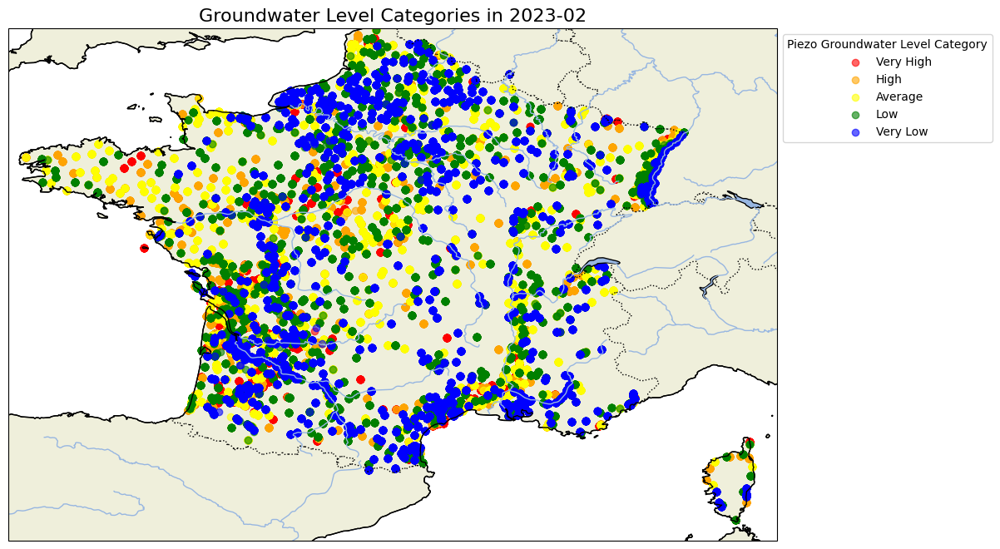

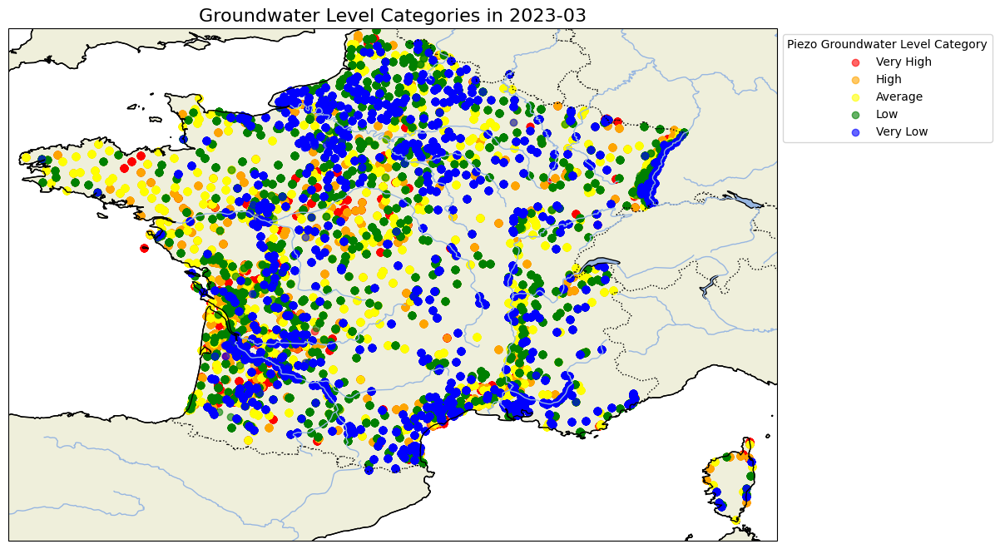

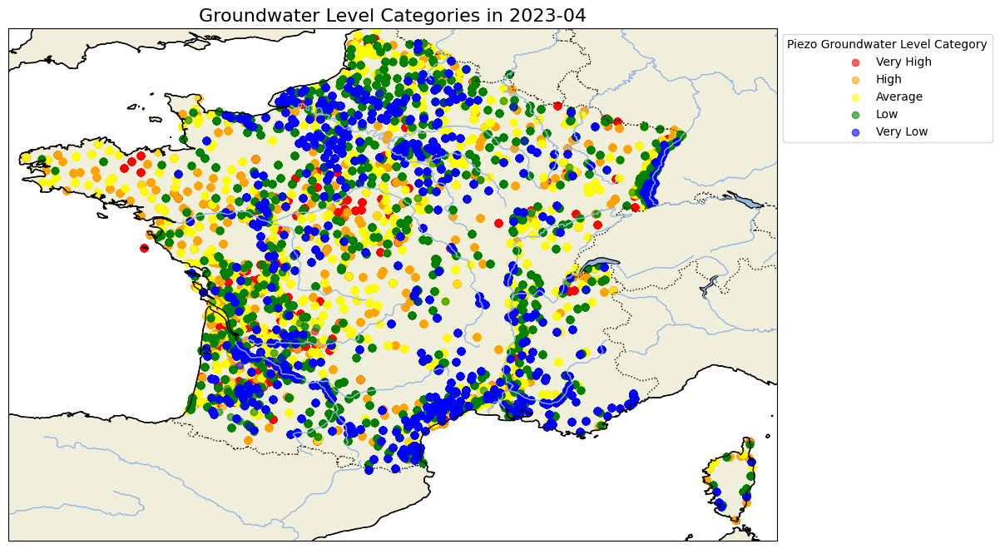

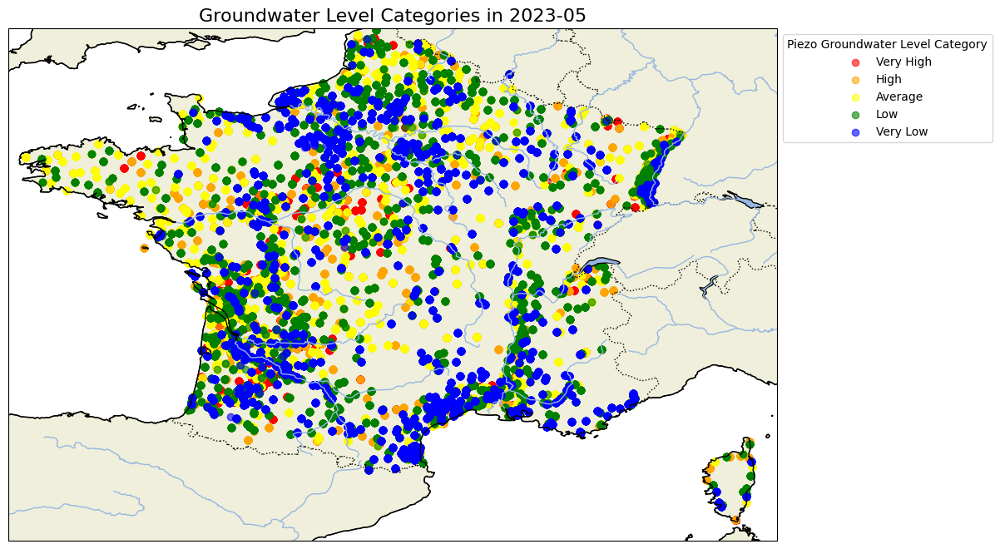

In [6]:
date_col = 'piezo_measurement_date'

train['update_year'] = pd.to_datetime(train[date_col], errors='coerce').dt.year
train['update_month'] = pd.to_datetime(train[date_col], errors='coerce').dt.month

data_with_year_month = train.dropna(subset=['update_year', 'update_month'])

unique_year_months = sorted(
    [tuple(x) for x in data_with_year_month[['update_year', 'update_month']].drop_duplicates().values]
)

categories = ['Very High', 'High', 'Average', 'Low', 'Very Low']
colors = ['red', 'orange', 'yellow', 'green', 'blue']
category_color_map = dict(zip(categories, colors))

for year, month in unique_year_months:
    year_month_data = data_with_year_month[
        (data_with_year_month['update_year'] == year) & 
        (data_with_year_month['update_month'] == month)
    ]
    
    plt.figure(figsize=(12, 8))
    ax = plt.axes(projection=ccrs.PlateCarree())

    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.LAKES, edgecolor='black')
    ax.add_feature(cfeature.RIVERS)

    min_longitude, max_longitude = -5, 10
    min_latitude, max_latitude = 41, 51
    ax.set_extent([min_longitude, max_longitude, min_latitude, max_latitude], crs=ccrs.PlateCarree())

    for category in categories:
        subset = year_month_data[year_month_data['piezo_groundwater_level_category'] == category]
        ax.scatter(
            subset[longitude_col],
            subset[latitude_col],
            color=category_color_map[category],
            label=category,
            alpha=0.6,
            transform=ccrs.PlateCarree()
        )

    plt.legend(title='Piezo Groundwater Level Category', loc='upper left', bbox_to_anchor=(1, 1))
    plt.title(f'Groundwater Level Categories in {year}-{month:02d}', fontsize=16)
    plt.show()


[2020, 2021, 2022, 2023]


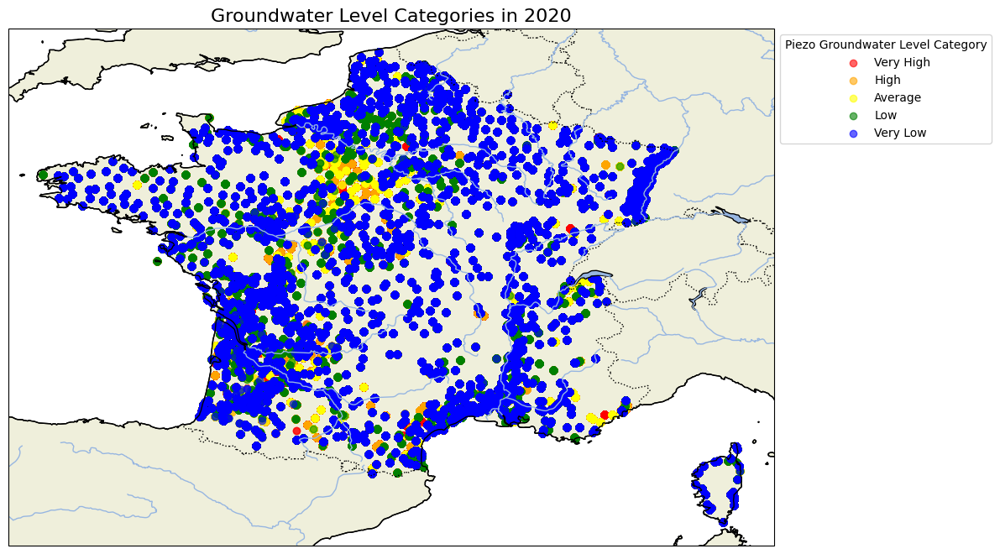

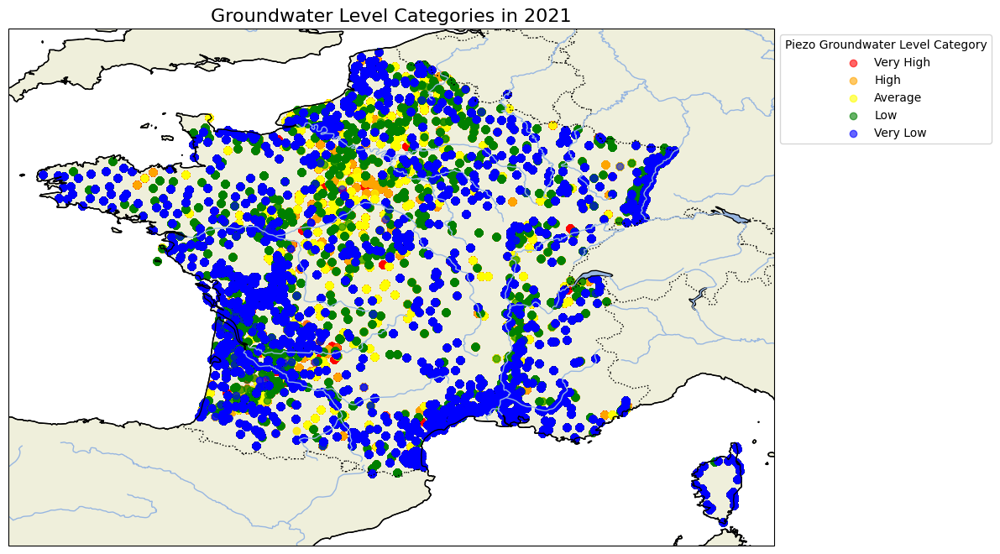

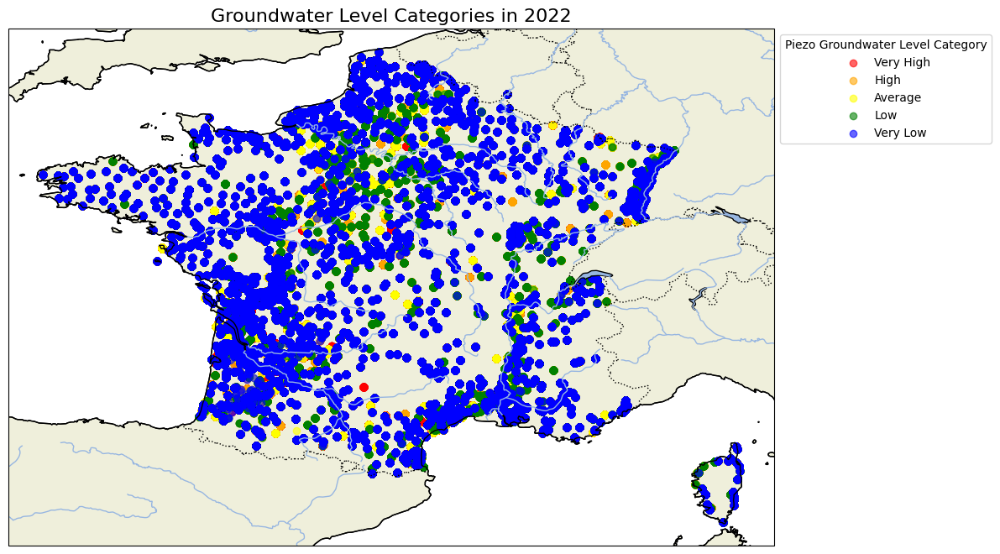

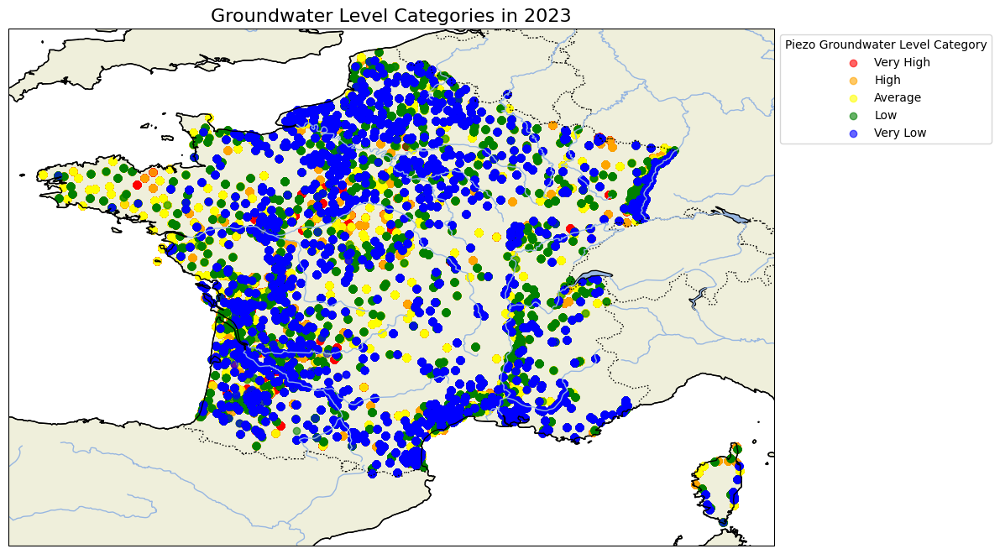

In [7]:
date_col = 'piezo_measurement_date'

if date_col not in train.columns:
    raise ValueError(f"The column {date_col} is missing in the dataset.")

train['update_year'] = pd.to_datetime(train[date_col], errors='coerce').dt.year

data_with_year = train.dropna(subset=['update_year'])

unique_years = sorted(data_with_year['update_year'].unique())

categories = ['Very High', 'High', 'Average', 'Low', 'Very Low']
colors = ['red', 'orange', 'yellow', 'green', 'blue']
category_color_map = dict(zip(categories, colors))

print(unique_years)

for year in unique_years:
    yearly_data = data_with_year[data_with_year['update_year'] == year]
    
    plt.figure(figsize=(12, 8))
    ax = plt.axes(projection=ccrs.PlateCarree())

    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.LAKES, edgecolor='black')
    ax.add_feature(cfeature.RIVERS)

    for category in categories:
        subset = yearly_data[yearly_data['piezo_groundwater_level_category'] == category]
        ax.scatter(
            subset[longitude_col],
            subset[latitude_col],
            color=category_color_map[category],
            label=category,
            alpha=0.6,
            transform=ccrs.PlateCarree()
        )

    plt.legend(title='Piezo Groundwater Level Category', loc='upper left', bbox_to_anchor=(1, 1))
    plt.title(f'Groundwater Level Categories in {year}', fontsize=16)
    plt.show()


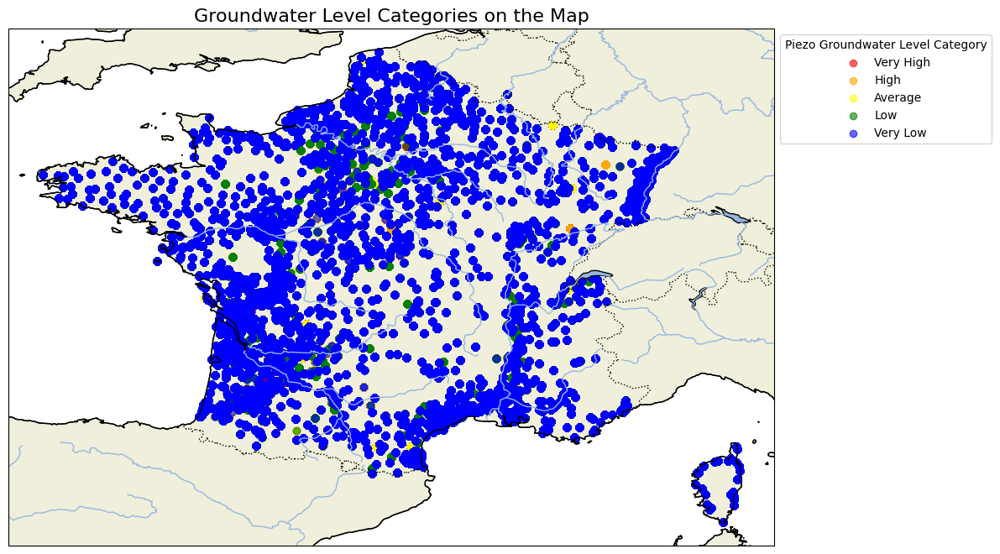

In [8]:
longitude_col = 'piezo_station_longitude'
latitude_col = 'piezo_station_latitude'

if longitude_col not in train.columns or latitude_col not in train.columns:
    raise ValueError("Longitude and latitude columns are missing in the dataset.")

data_to_plot = train[[longitude_col, latitude_col, 'piezo_groundwater_level_category']].dropna()

categories = ['Very High', 'High', 'Average', 'Low', 'Very Low']
colors = ['red', 'orange', 'yellow', 'green', 'blue']
category_color_map = dict(zip(categories, colors))

data_to_plot['color'] = data_to_plot['piezo_groundwater_level_category'].map(category_color_map)

plt.figure(figsize=(12, 8))
ax = plt.axes(projection=ccrs.PlateCarree())

ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.LAND, edgecolor='black')
ax.add_feature(cfeature.LAKES, edgecolor='black')
ax.add_feature(cfeature.RIVERS)

for category in categories:
    subset = data_to_plot[data_to_plot['piezo_groundwater_level_category'] == category]
    ax.scatter(
        subset[longitude_col],
        subset[latitude_col],
        color=category_color_map[category],
        label=category,
        alpha=0.6,
        transform=ccrs.PlateCarree()
    )

plt.legend(title='Piezo Groundwater Level Category', loc='upper left', bbox_to_anchor=(1, 1))
plt.title('Groundwater Level Categories on the Map', fontsize=16)
plt.show()

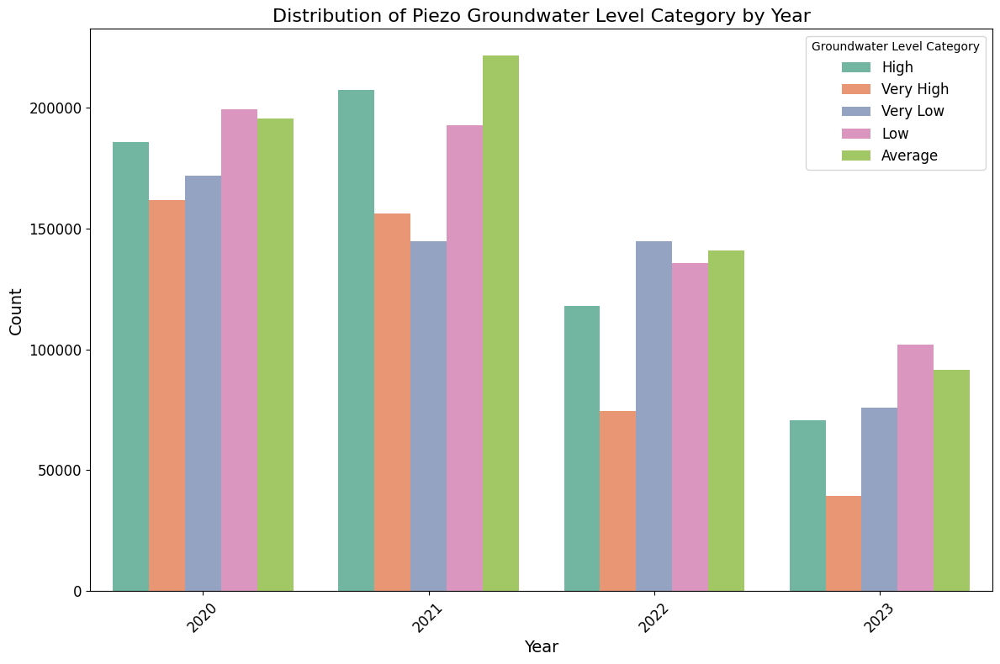

In [9]:
if 'update_year' not in train.columns:
    train['update_year'] = pd.to_datetime(train['piezo_measurement_date'], errors='coerce').dt.year

data_for_distribution = train.dropna(subset=['update_year', 'piezo_groundwater_level_category'])

plt.figure(figsize=(12, 8))
sns.countplot(
    data=data_for_distribution,
    x='update_year',
    hue='piezo_groundwater_level_category',
    palette='Set2'
)

plt.xlabel('Year', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.title('Distribution of Piezo Groundwater Level Category by Year', fontsize=16)
plt.legend(title='Groundwater Level Category', fontsize=12)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()
plt.show()

C:\Users\Bradf\AppData\Local\Temp\ipykernel_4140\415848292.py:8: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  nan_counts = combined.groupby(['year', 'month']).apply(lambda x: x.isna().sum().sum())


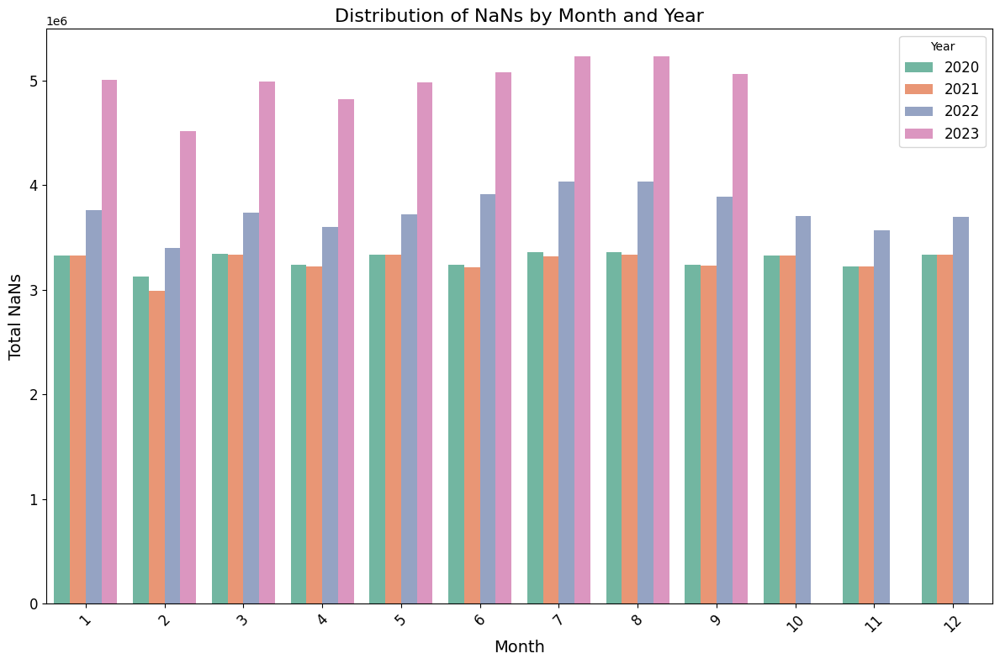

In [10]:
combined = pd.concat([train, test], keys=['train', 'test'])

combined['piezo_measurement_date'] = pd.to_datetime(combined['piezo_measurement_date'], errors='coerce')

combined['year'] = combined['piezo_measurement_date'].dt.year
combined['month'] = combined['piezo_measurement_date'].dt.month

nan_counts = combined.groupby(['year', 'month']).apply(lambda x: x.isna().sum().sum())

nan_counts = nan_counts.reset_index(name='total_nans')

plt.figure(figsize=(12, 8))
sns.barplot(data=nan_counts, x='month', y='total_nans', hue='year', palette='Set2')

plt.xlabel('Month', fontsize=14)
plt.ylabel('Total NaNs', fontsize=14)
plt.title('Distribution of NaNs by Month and Year', fontsize=16)
plt.legend(title='Year', fontsize=12)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()
plt.show()

## **Data Preprocess**

In [11]:
import math

data = pd.read_csv('data_preprocess.csv')

numerical_cols = data.select_dtypes(include=['int64', 'float64']).columns.tolist()

def detect_and_clip_outliers(df, numerical_columns):
    df_clipped = df.copy()
    
    for col in numerical_columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        df_clipped[col] = df[col].clip(lower=lower_bound, upper=upper_bound)
    return df_clipped

def plot_numerical_columns(df, numerical_columns):
    num_cols = len(numerical_columns)
    cols_per_row = 2
    rows = math.ceil(num_cols / cols_per_row)
    fig, axes = plt.subplots(rows * 2, cols_per_row, figsize=(20, rows * 10))  
    axes = axes.flatten()

    for i, col in enumerate(numerical_columns):
        sns.boxplot(x=df[col], ax=axes[i * 2])
        axes[i * 2].set_title(f'Box Plot of {col}')
        axes[i * 2].set_xlabel(col)
        
        sns.violinplot(x=df[col], ax=axes[i * 2 + 1])
        axes[i * 2 + 1].set_title(f'Violin Plot of {col}')
        axes[i * 2 + 1].set_xlabel(col)

    for j in range(i * 2 + 2, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

print("Plots before clipping outliers:")
plot_numerical_columns(data, numerical_cols)

Plots before clipping outliers:


In [12]:
data_clipped = detect_and_clip_outliers(data, numerical_cols)

In [13]:
print("Plots after clipping outliers:")
plot_numerical_columns(data_clipped, numerical_cols)

Plots after clipping outliers:


In [14]:
data_clipped.to_csv('data_processed_clipped.csv', index=False)

---

## **Model Exploration**

### **ExtraTrees**

In [ ]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

train = pd.read_csv('X_train_Hi5.csv', nrows=50_000)  
test = pd.read_csv('X_test_Hi5.csv', nrows=10_000)

def preprocess_data(df, preprocessor=None, is_train=True):
    date_cols = [col for col in df.columns if 'date' in col.lower()]
    for col in date_cols:
        df[col] = pd.to_datetime(df[col], errors='coerce')

    numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
    categorical_cols = df.select_dtypes(include=['object']).columns.tolist()

    target = 'piezo_groundwater_level_category'
    if target in df.columns:
        if target in numerical_cols:
            numerical_cols.remove(target)
        if target in categorical_cols:
            categorical_cols.remove(target)

    df[categorical_cols] = df[categorical_cols].astype(str)

    num_imputer = SimpleImputer(strategy='median')
    cat_imputer = SimpleImputer(strategy='most_frequent')

    scaler = StandardScaler()

    cat_encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)

    num_pipeline = Pipeline([
        ('imputer', num_imputer),
        ('scaler', scaler)
    ])

    cat_pipeline = Pipeline([
        ('imputer', cat_imputer),
        ('encoder', cat_encoder)
    ])

    if preprocessor is None:
        preprocessor = ColumnTransformer([
            ('num', num_pipeline, numerical_cols),
            ('cat', cat_pipeline, categorical_cols)
        ], remainder='drop')  
    else:
        preprocessor.transformers[0] = ('num', num_pipeline, numerical_cols)
        preprocessor.transformers[1] = ('cat', cat_pipeline, categorical_cols)

    if is_train:
        X = preprocessor.fit_transform(df)
        y = df[target] if target in df.columns else None
        return X, y, preprocessor
    else:
        X = preprocessor.transform(df)
        return X

X_train, y_train, preprocessor = preprocess_data(train, is_train=True)
X_test = preprocess_data(test, preprocessor=preprocessor, is_train=False)

label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)

X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train_encoded, test_size=0.2, random_state=42)

model = ExtraTreesClassifier(n_estimators=100, random_state=42)
model.fit(X_tr, y_tr)

train_preds = model.predict(X_tr)
val_preds = model.predict(X_val)

train_score = f1_score(y_tr, train_preds, average='weighted')
print(f'Train F1 Score: {train_score:.4f}')

val_score = f1_score(y_val, val_preds, average='weighted')
print(f'Validation F1 Score: {val_score:.4f}')

test_preds = model.predict(X_test)
test_preds = label_encoder.inverse_transform(test_preds)

test_predictions = pd.DataFrame({
    'row_index': test.index,
    'piezo_groundwater_level_category': test_preds
})

test_predictions.to_csv('y_test_Hi5_ExtraTree.csv', index=False)

C:\Users\Bradf\AppData\Local\Temp\ipykernel_4140\3026401803.py:9: DtypeWarning: Columns (1,5) have mixed types. Specify dtype option on import or set low_memory=False.
  train = pd.read_csv('X_train_Hi5.csv', nrows=50_000)
C:\Users\Bradf\AppData\Local\Temp\ipykernel_4140\3026401803.py:15: FutureWarning: Parsed string "Sun Jul 14 13:00:02 CEST 2024" included an un-recognized timezone "CEST". Dropping unrecognized timezones is deprecated; in a future version this will raise. Instead pass the string without the timezone, then use .tz_localize to convert to a recognized timezone.
  df[col] = pd.to_datetime(df[col], errors='coerce')
c:\Users\Bradf\anaconda3\envs\hiparis\lib\site-packages\sklearn\impute\_base.py:598: UserWarning: Skipping features without any observed values: ['meteo_radiation_IR']. At least one non-missing value is needed for imputation with strategy='median'.
  warnings.warn(
C:\Users\Bradf\AppData\Local\Temp\ipykernel_4140\3026401803.py:15: FutureWarning: Parsed string "S

----

### **Random Forest**

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score
from sklearn.ensemble import RandomForestClassifier

train = pd.read_csv('X_train_Hi5.csv', nrows=50_000) 
test = pd.read_csv('X_test_Hi5.csv', nrows=10_000)   

def preprocess_data(df, preprocessor=None, is_train=True):
    date_cols = [col for col in df.columns if 'date' in col.lower()]
    for col in date_cols:
        df[col] = pd.to_datetime(df[col], errors='coerce')

    numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
    categorical_cols = df.select_dtypes(include=['object']).columns.tolist()

    target = 'piezo_groundwater_level_category'
    if target in df.columns:
        if target in numerical_cols:
            numerical_cols.remove(target)
        if target in categorical_cols:
            categorical_cols.remove(target)

    df[categorical_cols] = df[categorical_cols].astype(str)

    num_imputer = SimpleImputer(strategy='median')
    cat_imputer = SimpleImputer(strategy='most_frequent')

    scaler = StandardScaler()

    cat_encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)

    num_pipeline = Pipeline([
        ('imputer', num_imputer),
        ('scaler', scaler)
    ])

    cat_pipeline = Pipeline([
        ('imputer', cat_imputer),
        ('encoder', cat_encoder)
    ])

    if preprocessor is None:
        preprocessor = ColumnTransformer([
            ('num', num_pipeline, numerical_cols),
            ('cat', cat_pipeline, categorical_cols)
        ], remainder='drop')  
    else:
        preprocessor.transformers[0] = ('num', num_pipeline, numerical_cols)
        preprocessor.transformers[1] = ('cat', cat_pipeline, categorical_cols)

    if is_train:
        X = preprocessor.fit_transform(df)
        y = df[target] if target in df.columns else None
        return X, y, preprocessor
    else:
        X = preprocessor.transform(df)
        return X

X_train, y_train, preprocessor = preprocess_data(train, is_train=True)
X_test = preprocess_data(test, preprocessor=preprocessor, is_train=False)

from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)

X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train_encoded, test_size=0.2, random_state=42)

clf = RandomForestClassifier(
    n_estimators=100,  
    max_depth=None,    
    random_state=42,   
    n_jobs=-1          
)

clf.fit(X_tr, y_tr)
y_val_pred = clf.predict(X_val)
f1 = f1_score(y_val, y_val_pred, average='weighted')
print(f"Weighted F1 Score on Validation Set: {f1:.4f}")

y_test_pred = clf.predict(X_test)
y_test_pred_labels = label_encoder.inverse_transform(y_test_pred)

test_predictions = pd.DataFrame({
    'row_index': test.index,  
    'piezo_groundwater_level_category': y_test_pred_labels
})

submission = pd.DataFrame({'piezo_groundwater_level_category': y_test_pred_labels})

test_predictions.to_csv('y_test_Hi5_RF.csv', index=False)

----

#### **Feature Importance**

In [ ]:
feature_importances = clf.feature_importances_

numerical_features = preprocessor.transformers_[0][2] 
categorical_features = preprocessor.transformers_[1][1]['encoder'].get_feature_names_out(preprocessor.transformers_[1][2])  # Encoded categorical features

feature_names = list(numerical_features) + list(categorical_features)
feature_names = [name for name in feature_names if name != 'insee_%_const_nan']

print(f"Nombre de noms de features : {len(feature_names)}")
print(f"Nombre d'importances : {len(feature_importances)}")

if len(feature_names) == len(feature_importances):
    importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': feature_importances
    }).sort_values(by='Importance', ascending=False)

    plt.figure(figsize=(10, 6))
    plt.barh(importance_df['Feature'], importance_df['Importance'], color='skyblue')
    plt.xlabel('Importance', fontsize=14)
    plt.ylabel('Feature', fontsize=14)
    plt.title('Feature Importances from Random Forest', fontsize=16)
    plt.gca().invert_yaxis()
    plt.tight_layout()
    plt.show()
else:
    print("Erreur : Les longueurs des noms de features et des importances ne correspondent pas.")
    extra_features = feature_names[len(feature_importances):]
    print("Colonnes en trop :")
    print(extra_features)

In [ ]:
N = 45
top_features = importance_df.head(N)

plt.figure(figsize=(10, 6))
plt.barh(top_features['Feature'], top_features['Importance'], color='skyblue')
plt.xlabel('Importance', fontsize=14)
plt.ylabel('Feature', fontsize=14)
plt.title(f'Top {N} Feature Importances from Random Forest', fontsize=16)
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

In [ ]:
N = 45
worst_features = importance_df.tail(N)
print(worst_features)
plt.figure(figsize=(10, 6))
plt.barh(worst_features['Feature'], worst_features['Importance'], color='skyblue')
plt.xlabel('Importance', fontsize=14)
plt.ylabel('Feature', fontsize=14)
plt.title(f'Bottom {N} Feature Importances from Random Forest', fontsize=16)
plt.gca().invert_yaxis() 
plt.tight_layout()
plt.show()

In [ ]:
# low_importance_threshold = 0.001
# low_importance_features = importance_df[importance_df['Importance'] < low_importance_threshold]['Feature']

# columns_to_drop = low_importance_features.tolist()
# train = train.drop(columns=columns_to_drop, errors='ignore')
# test = test.drop(columns=columns_to_drop, errors='ignore')

In [ ]:
# print(f"Train data shape: {train.shape}")
# print(f"Test data shape: {test.shape}")

In [ ]:
# from sklearn.pipeline import Pipeline
# from sklearn.preprocessing import OneHotEncoder, StandardScaler
# from sklearn.impute import SimpleImputer
# from sklearn.compose import ColumnTransformer
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import f1_score
# from sklearn.ensemble import RandomForestClassifier
# # train = pd.read_csv('X_train_Hi5.csv', nrows=100000)
# # test = pd.read_csv('X_test_Hi5.csv', nrows=2000)

# # train = pd.read_csv('X_train_Hi5.csv', nrows=50_000)  
# # test = pd.read_csv('X_test_Hi5.csv', nrows=10_000)    

# # train = train.sample(frac=1, random_state=42).reset_index(drop=True)  
# # test = test.sample(frac=1, random_state=42).reset_index(drop=True)    

# # train = train.iloc[:100_000]
# # test = test.iloc[:2_000]

# def preprocess_data(df, preprocessor=None, is_train=True):
#     date_cols = [col for col in df.columns if 'date' in col.lower()]
#     for col in date_cols:
#         df[col] = pd.to_datetime(df[col], errors='coerce')

#     numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
#     categorical_cols = df.select_dtypes(include=['object']).columns.tolist()

#     target = 'piezo_groundwater_level_category'
#     if target in df.columns:
#         if target in numerical_cols:
#             numerical_cols.remove(target)
#         if target in categorical_cols:
#             categorical_cols.remove(target)

#     df[categorical_cols] = df[categorical_cols].astype(str)

#     num_imputer = SimpleImputer(strategy='median')
#     cat_imputer = SimpleImputer(strategy='most_frequent')

#     scaler = StandardScaler()

#     cat_encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)

#     num_pipeline = Pipeline([
#         ('imputer', num_imputer),
#         ('scaler', scaler)
#     ])

#     cat_pipeline = Pipeline([
#         ('imputer', cat_imputer),
#         ('encoder', cat_encoder)
#     ])

#     if preprocessor is None:
#         preprocessor = ColumnTransformer([
#             ('num', num_pipeline, numerical_cols),
#             ('cat', cat_pipeline, categorical_cols)
#         ], remainder='drop') 
#     else:
#         preprocessor.transformers[0] = ('num', num_pipeline, numerical_cols)
#         preprocessor.transformers[1] = ('cat', cat_pipeline, categorical_cols)

#     if is_train:
#         X = preprocessor.fit_transform(df)
#         y = df[target] if target in df.columns else None
#         return X, y, preprocessor
#     else:
#         X = preprocessor.transform(df)
#         return X

# X_train, y_train, preprocessor = preprocess_data(train, is_train=True)
# X_test = preprocess_data(test, preprocessor=preprocessor, is_train=False)

# from sklearn.preprocessing import LabelEncoder
# label_encoder = LabelEncoder()
# y_train_encoded = label_encoder.fit_transform(y_train)

# X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train_encoded, test_size=0.2, random_state=42)

# clf = RandomForestClassifier(
#     n_estimators=100, 
#     max_depth=None,    
#     random_state=42,   
#     n_jobs=-1          
# )

# clf.fit(X_tr, y_tr)

# y_val_pred = clf.predict(X_val)

# f1 = f1_score(y_val, y_val_pred, average='weighted')
# print(f"Weighted F1 Score on Validation Set: {f1:.4f}")

# y_test_pred = clf.predict(X_test)

# y_test_pred_labels = label_encoder.inverse_transform(y_test_pred)

# test_predictions = pd.DataFrame({
#     'row_index': test.index,  # Use the index if 'row_index' does not exist
#     'piezo_groundwater_level_category': y_test_pred_labels
# })

# submission = pd.DataFrame({'piezo_groundwater_level_category': y_test_pred_labels})

# test_predictions.to_csv('y_test_Hi5_RF.csv', index=False)

----

### **CatBoost**

In [ ]:
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score
from catboost import CatBoostClassifier, Pool
from sklearn.preprocessing import LabelEncoder

train = pd.read_csv('X_train_Hi5.csv', nrows=400_000) 
test = pd.read_csv('X_test_Hi5.csv', nrows=2_000)

def preprocess_data(df, is_train=True, feature_columns=None, categorical_cols=None):
    date_cols = [col for col in df.columns if 'date' in col.lower()]
    for col in date_cols:
        df[col] = pd.to_datetime(df[col], errors='coerce')

    for col in date_cols:
        df[col + '_year'] = df[col].dt.year
        df[col + '_month'] = df[col].dt.month
        df[col + '_day'] = df[col].dt.day
        df[col + '_dayofweek'] = df[col].dt.dayofweek
        df[col + '_dayofyear'] = df[col].dt.dayofyear
        df[col + '_is_weekend'] = df[col].dt.dayofweek > 4
        df.drop(col, axis=1, inplace=True)

    if is_train:
        numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
        categorical_cols = df.select_dtypes(include=['object', 'bool']).columns.tolist()
        target = 'piezo_groundwater_level_category'
        if target in df.columns:
            if target in numerical_cols:
                numerical_cols.remove(target)
            if target in categorical_cols:
                categorical_cols.remove(target)
        df[categorical_cols] = df[categorical_cols].astype(str)

        y = df[target] if target in df.columns else None
        X = df.drop(target, axis=1) if target in df.columns else df
        feature_columns = X.columns.tolist()
        return X, y, categorical_cols, feature_columns
    else:
        df[categorical_cols] = df[categorical_cols].astype(str)
        X = df
        missing_cols = set(feature_columns) - set(X.columns)
        for col in missing_cols:
            X[col] = np.nan
        X = X[feature_columns]
        return X

X_train, y_train, categorical_cols, feature_columns = preprocess_data(train, is_train=True)
X_test = preprocess_data(test, is_train=False, feature_columns=feature_columns, categorical_cols=categorical_cols)

label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)

X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train_encoded, test_size=0.2, random_state=42)

cat_features = [X_train.columns.get_loc(col) for col in categorical_cols]

clf = CatBoostClassifier(
    iterations=100,
    learning_rate=0.1,
    random_seed=42,
    eval_metric='MultiClass',
    verbose=10
)

train_pool = Pool(data=X_tr, label=y_tr, cat_features=cat_features)
val_pool = Pool(data=X_val, label=y_val, cat_features=cat_features)
test_pool = Pool(data=X_test, cat_features=cat_features)

clf.fit(
    train_pool,
    eval_set=val_pool,
    early_stopping_rounds=10
)

y_val_pred = clf.predict(val_pool)
y_val_pred = y_val_pred.flatten().astype(int)

f1 = f1_score(y_val, y_val_pred, average='weighted')
print(f"Weighted F1 Score on Validation Set: {f1:.4f}")

y_test_pred = clf.predict(test_pool)
y_test_pred = y_test_pred.flatten().astype(int)

y_test_pred_labels = label_encoder.inverse_transform(y_test_pred)

test_predictions = pd.DataFrame({
    'row_index': test.index, 
    'piezo_groundwater_level_category': y_test_pred_labels
})

submission = pd.DataFrame({'piezo_groundwater_level_category': y_test_pred_labels})

test_predictions.to_csv('y_test_Hi5_CatBoost.csv', index=False)

---

### **LGBM: Light Gradient Boosting Machine**

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score
import lightgbm as lgb

train = pd.read_csv('X_train_Hi5.csv', nrows=400_000)
test = pd.read_csv('X_test_Hi5.csv', nrows=2_000)  


def preprocess_data(df, preprocessor=None, is_train=True):
    date_cols = [col for col in df.columns if 'date' in col.lower()]
    for col in date_cols:
        df[col] = pd.to_datetime(df[col], errors='coerce')

    numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
    categorical_cols = df.select_dtypes(include=['object']).columns.tolist()

    target = 'piezo_groundwater_level_category'
    if target in df.columns:
        if target in numerical_cols:
            numerical_cols.remove(target)
        if target in categorical_cols:
            categorical_cols.remove(target)

    df[categorical_cols] = df[categorical_cols].astype(str)

    num_imputer = SimpleImputer(strategy='median')
    cat_imputer = SimpleImputer(strategy='most_frequent')

    scaler = StandardScaler()

    cat_encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)

    num_pipeline = Pipeline([
        ('imputer', num_imputer),
        ('scaler', scaler)
    ])

    cat_pipeline = Pipeline([
        ('imputer', cat_imputer),
        ('encoder', cat_encoder)
    ])

    if preprocessor is None:
        preprocessor = ColumnTransformer([
            ('num', num_pipeline, numerical_cols),
            ('cat', cat_pipeline, categorical_cols)
        ], remainder='drop') 
    else:
        preprocessor.transformers[0] = ('num', num_pipeline, numerical_cols)
        preprocessor.transformers[1] = ('cat', cat_pipeline, categorical_cols)

    if is_train:
        X = preprocessor.fit_transform(df)
        y = df[target] if target in df.columns else None
        return X, y, preprocessor
    else:
        X = preprocessor.transform(df)
        return X

X_train, y_train, preprocessor = preprocess_data(train, is_train=True)

X_test = preprocess_data(test, preprocessor=preprocessor, is_train=False)

from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)

X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train_encoded, test_size=0.2, random_state=42)

clf = lgb.LGBMClassifier(
    boosting_type='gbdt',
    objective='multiclass',
    num_class=len(np.unique(y_train_encoded)),
    n_estimators=100,
    learning_rate=0.1,
    random_state=42
)

clf.fit(X_tr, y_tr,
        eval_set=[(X_val, y_val)],
        eval_metric='multi_logloss')

y_val_pred = clf.predict(X_val)

f1 = f1_score(y_val, y_val_pred, average='weighted')
print(f"Weighted F1 Score on Validation Set: {f1:.4f}")

y_test_pred = clf.predict(X_test)
y_test_pred_labels = label_encoder.inverse_transform(y_test_pred)

test_predictions = pd.DataFrame({
    'row_index': test.index,  
    'piezo_groundwater_level_category': y_test_pred_labels
})

submission = pd.DataFrame({'piezo_groundwater_level_category': y_test_pred_labels})
test_predictions.to_csv('y_test_Hi5_LGBM.csv', index=False)

In [ ]:


# # Import necessary libraries
# import pandas as pd
# import numpy as np
# from sklearn.pipeline import Pipeline
# from sklearn.preprocessing import OneHotEncoder, StandardScaler
# from sklearn.impute import SimpleImputer
# from sklearn.compose import ColumnTransformer
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import f1_score
# import lightgbm as lgb

# # Load the data
# train = pd.read_csv('X_train_Hi5.csv')
# test = pd.read_csv('X_test_Hi5.csv')

# # Function to preprocess data
# def preprocess_data(df, preprocessor=None, is_train=True):
#     # Convert date columns to datetime
#     date_cols = [col for col in df.columns if 'date' in col.lower()]
#     for col in date_cols:
#         df[col] = pd.to_datetime(df[col], errors='coerce')

#     # Identify numerical and categorical columns
#     numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
#     categorical_cols = df.select_dtypes(include=['object']).columns.tolist()

#     # Remove target variable from features if it's in the dataset
#     target = 'piezo_groundwater_level_category'
#     if target in df.columns:
#         if target in numerical_cols:
#             numerical_cols.remove(target)
#         if target in categorical_cols:
#             categorical_cols.remove(target)

#     # Convert categorical columns to strings
#     df[categorical_cols] = df[categorical_cols].astype(str)

#     # Imputation strategies
#     num_imputer = SimpleImputer(strategy='median')
#     cat_imputer = SimpleImputer(strategy='most_frequent')

#     # Scaling
#     scaler = StandardScaler()

#     # Encoding categorical variables
#     cat_encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)

#     # Build pipelines for numerical and categorical data
#     num_pipeline = Pipeline([
#         ('imputer', num_imputer),
#         ('scaler', scaler)
#     ])

#     cat_pipeline = Pipeline([
#         ('imputer', cat_imputer),
#         ('encoder', cat_encoder)
#     ])

#     # Combine numerical and categorical pipelines
#     if preprocessor is None:
#         preprocessor = ColumnTransformer([
#             ('num', num_pipeline, numerical_cols),
#             ('cat', cat_pipeline, categorical_cols)
#         ], remainder='drop')  # Drop any columns not specified
#     else:
#         # Update the transformers with the correct columns
#         preprocessor.transformers[0] = ('num', num_pipeline, numerical_cols)
#         preprocessor.transformers[1] = ('cat', cat_pipeline, categorical_cols)

#     if is_train:
#         # Fit and transform the data
#         X = preprocessor.fit_transform(df)
#         y = df[target] if target in df.columns else None
#         return X, y, preprocessor
#     else:
#         # Transform the data using the existing preprocessor
#         X = preprocessor.transform(df)
#         return X

# # Preprocess training data
# X_train, y_train, preprocessor = preprocess_data(train, is_train=True)

# # Preprocess test data using the same preprocessor
# X_test = preprocess_data(test, preprocessor=preprocessor, is_train=False)

# # Encode target variable if it's categorical
# from sklearn.preprocessing import LabelEncoder
# label_encoder = LabelEncoder()
# y_train_encoded = label_encoder.fit_transform(y_train)

# # Split the data into training and validation sets
# X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train_encoded, test_size=0.2, random_state=42)

# # Initialize the LightGBM classifier
# clf = lgb.LGBMClassifier(
#     boosting_type='gbdt',
#     objective='multiclass',
#     num_class=len(np.unique(y_train_encoded)),
#     n_estimators=100,
#     learning_rate=0.1,
#     random_state=42
# )

# # Train the model
# clf.fit(X_tr, y_tr,
#         eval_set=[(X_val, y_val)],
#         eval_metric='multi_logloss')

# # Predict on validation set
# y_val_pred = clf.predict(X_val)

# # Calculate weighted F1 score
# f1 = f1_score(y_val, y_val_pred, average='weighted')
# print(f"Weighted F1 Score on Validation Set: {f1:.4f}")

# # Predict on test data
# y_test_pred = clf.predict(X_test)

# # If you need to convert predictions back to original labels
# y_test_pred_labels = label_encoder.inverse_transform(y_test_pred)

# # Create a DataFrame for submission or further analysis
# test_predictions = pd.DataFrame({
#     'row_index': test.index,  # Use the index if 'row_index' does not exist
#     'piezo_groundwater_level_category': y_test_pred_labels
# })

# submission = pd.DataFrame({'piezo_groundwater_level_category': y_test_pred_labels})

# # Enregistrer les prédictions dans un fichier CSV

# submission.to_csv('y_test_Hi5_LGBM_all.csv', index=False)
# # print(test_predictions.head())


---

### **XGBoost : Extreme Gradient Boosting**

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score
from xgboost import XGBClassifier

train = pd.read_csv('X_train_Hi5.csv', nrows=10000)
test = pd.read_csv('X_test_Hi5.csv', nrows=10000)

def preprocess_data(df, preprocessor=None, is_train=True):
    date_cols = [col for col in df.columns if 'date' in col.lower()]
    for col in date_cols:
        df[col] = pd.to_datetime(df[col], errors='coerce')

    numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
    categorical_cols = df.select_dtypes(include=['object']).columns.tolist()

    target = 'piezo_groundwater_level_category'
    if target in df.columns:
        if target in numerical_cols:
            numerical_cols.remove(target)
        if target in categorical_cols:
            categorical_cols.remove(target)

    df[categorical_cols] = df[categorical_cols].astype(str)

    num_imputer = SimpleImputer(strategy='median')
    cat_imputer = SimpleImputer(strategy='most_frequent')

    scaler = StandardScaler()

    cat_encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)

    num_pipeline = Pipeline([
        ('imputer', num_imputer),
        ('scaler', scaler)
    ])

    cat_pipeline = Pipeline([
        ('imputer', cat_imputer),
        ('encoder', cat_encoder)
    ])

    if preprocessor is None:
        preprocessor = ColumnTransformer([
            ('num', num_pipeline, numerical_cols),
            ('cat', cat_pipeline, categorical_cols)
        ], remainder='drop')  
    else:
        preprocessor.transformers[0] = ('num', num_pipeline, numerical_cols)
        preprocessor.transformers[1] = ('cat', cat_pipeline, categorical_cols)

    if is_train:
        X = preprocessor.fit_transform(df)
        y = df[target] if target in df.columns else None
        return X, y, preprocessor
    else:
        X = preprocessor.transform(df)
        return X

X_train, y_train, preprocessor = preprocess_data(train, is_train=True)
X_test = preprocess_data(test, preprocessor=preprocessor, is_train=False)

from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)

X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train_encoded, test_size=0.2, random_state=42)

clf = XGBClassifier(
    objective='multi:softmax',
    num_class=len(np.unique(y_train_encoded)),
    n_estimators=100,
    learning_rate=0.1,
    max_depth=6,
    random_state=42,
    eval_metric='mlogloss',  
    use_label_encoder=False
)

clf.fit(X_tr, y_tr,
        eval_set=[(X_val, y_val)],
        verbose=True)

y_val_pred = clf.predict(X_val)

f1 = f1_score(y_val, y_val_pred, average='weighted')
print(f"Weighted F1 Score on Validation Set: {f1:.4f}")

y_test_pred = clf.predict(X_test)
y_test_pred_labels = label_encoder.inverse_transform(y_test_pred)

submission = pd.DataFrame({'piezo_groundwater_level_category': y_test_pred_labels})
submission.to_csv('y_test_Hi5_xgboost.csv', index=False)

----------------

## **Visualizations**

In [ ]:
train = pd.read_csv('X_train_Hi5.csv')
test = pd.read_csv('X_test_Hi5.csv')

In [ ]:
print((train.shape, test.shape))

In [ ]:
pd.set_option('display.max_columns', 136)

In [ ]:
print(train['piezo_groundwater_level_category'].value_counts())
train['piezo_groundwater_level_category'].hist(bins=50, figsize=(20,15))
plt.show()

In [ ]:
missing_values = train.isna().sum()
missing_values = missing_values[missing_values > 0]
print("Colonnes avec des valeurs manquantes :")
print(missing_values)

In [ ]:
numeric_cols = train.select_dtypes(include=['float64', 'int64']).columns

for col in numeric_cols:
    if train[col].isna().sum() > 0: 
        plt.figure(figsize=(10, 5))
        train[col].hist(bins=30, alpha=0.7)
        plt.title(f"Distribution of {col}")
        plt.show()

categorical_cols = train.select_dtypes(include=['object']).columns
for col in categorical_cols:
    if train[col].isna().sum() > 0:
        print(f"Colonne {col}: {train[col].value_counts()}")